# Ego4D Moments (NLQ) Extension

Please set your resources to GPU (Runtime -> Change runtime type -> GPU).


To begin: add your **access keys** below, change your Runtime Type to **GPU**, and run cells **one by one** as you read through. This helps avoid timeouts since Colab gives more GPU cycles to interactive notebooks.

## Resources
- [Baseline Repo](https://github.com/EGO4D/episodic-memory/tree/main/NLQ/VSLNet)
- [Docs](https://ego4d-data.org/docs/benchmarks/episodic-memory/)
- [EvalAI Challenge](https://eval.ai/web/challenges/challenge-page/1629/overview)

## Download Data and Setup Environment

### **Fill In Your Access Info Here**
If you don't have access and secret keys, first sign the Ego4D License at [ego4ddataset.com](https://ego4ddataset.com)

In [ ]:
import os
os.environ['AWS_ACCESS_KEY_ID'] = "AWS_ACCESS_KEY_ID
os.environ['AWS_SECRET_ACCESS_KEY'] = "AWS_ACCESS_KEY"

### **Set up CLIs (Commnad line Interface) and Download Annotations + Repo**

In [ ]:
# Download the AWS and Ego4D CLIs, then download the annotations locally
%%bash

# Set up the AWS CLI
curl "https://awscli.amazonaws.com/awscli-exe-linux-x86_64.zip" -o "awscliv2.zip"
unzip -o awscliv2.zip >/dev/null
sudo ./aws/install >/dev/null 2>&1
aws configure set aws_access_key_id "$AWS_ACCESS_KEY_ID" && aws configure set aws_secret_access_key "$AWS_SECRET_ACCESS_KEY"
rm "awscliv2.zip"

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 63.0M  100 63.0M    0     0   273M      0 --:--:-- --:--:-- --:--:--  273M


### Install the ego4d CLI and Download Data

In [ ]:
# Set up the Ego4D CLI
!pip install ego4d

In [ ]:
# Download the Ego4D Annotations to ego4d_data/
# Download Ego4D annotations and features for version v1
!ego4d --output_directory="/content/ego4d_data/" --datasets annotations omnivore_video_swinl_fp16 --benchmarks nlq --version v1 -y


Datasets to download: {'omnivore_video_swinl_fp16', 'annotations'}
Download Path: /content/ego4d_data/v1
Ego4D Metadata: /content/ego4d_data/ego4d.json
Checking requested datasets and versions...
Created download directory for version 'v1' of dataset: 'omnivore_video_swinl_fp16' at: /content/ego4d_data/v1/omnivore_video_swinl_fp16
Filtering by benchmarks: ['nlq']
Created download directory for version 'v1' of dataset: 'annotations' at: /content/ego4d_data/v1/annotations
Benchmarks specified but ignored without a benchmarks field in manifest.
Retrieving object metadata from S3...
100% 1290/1290 [00:01<00:00, 946.11object/s]
Checking if latest file versions are already downloaded...
 10% 132/1290 [00:05<00:20, 57.78file/s]WARNING:urllib3.connectionpool:Connection pool is full, discarding connection: ego4d-kaust.s3.us-west-1.amazonaws.com. Connection pool size: 10
 97% 1252/1290 [00:19<00:00, 80.53file/s]WARNING:urllib3.connectionpool:Connection pool is full, discarding connection: ego4d-

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Check Downloaded Files

In [ ]:
# Ensure we have downloaded the files correctly
!ls /content/ego4d_data/v1/annotations | grep nlq

nlq_test_unannotated.json
nlq_train.json
nlq_val.json


In [ ]:
!ls /content/ego4d_data/v1/omnivore_video_swinl_fp16 | wc -l

1260


### Clone the Episodic Memory Baseline Repository

In [ ]:
%%bash
git clone https://github.com/EGO4D/episodic-memory
cd episodic-memory
git pull
git checkout nlq_fixes_and_fp16_support

Already up to date.
Branch 'nlq_fixes_and_fp16_support' set up to track remote branch 'nlq_fixes_and_fp16_support' from 'origin'.


Cloning into 'episodic-memory'...
Switched to a new branch 'nlq_fixes_and_fp16_support'


In [ ]:
!sed -i "s/from transformers import AdamW, get_linear_schedule_with_warmup/from transformers import get_linear_schedule_with_warmup\\nfrom torch.optim import AdamW/" episodic-memory/NLQ/VSLNet/model/VSLNet.py


# Prepare Dataset

The NLQ baseline repository for VSLNet requires you to prepare the data for training and evaluation purposes. From the [README.md](https://github.com/EGO4D/episodic-memory/blob/main/NLQ/VSLNet/README.md#preparation) we need to run the `prepare_ego4d_dataset.py` script.

### Setup Environment Variables for NLQ

First let's setup some environment variables and setup the paths as NLQ's scripts will expect.

In [ ]:
with open("vars.sh", "w") as out_f:
    out_f.write("""
  export NAME=omnivore_video_fp16
  export TASK_NAME=nlq_official_v1_$NAME

  export FEATURE_BASE_DIR="/content/ego4d_data/v1/omnivore_video_swinl_fp16"
  export FEATURE_DIR=$FEATURE_BASE_DIR

  export BASE_DIR="/content/data_output/$TASK_NAME"
  export MODEL_BASE_DIR="/content/nlq_official_v1/checkpoints/$NAME"
  """
)


In [ ]:
%%bash

source vars.sh

echo $FEATURE_BASE_DIR
mkdir -p $FEATURE_BASE_DIR
#ln -sf /content/ego4d_data/v1/omnivore_video_swinl_fp16 "$FEATURE_DIR"

/content/ego4d_data/v1/omnivore_video_swinl_fp16


In [ ]:
%%bash
%%capture

source vars.sh
pip install nltk submitit torch torchaudio torchvision tqdm transformers tensorboard Pillow terminaltables

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.5/75.5 kB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 119.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 93.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 12.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 14.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 11.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 102.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninsta

bash: line 1: fg: no job control


# Train and Evaluation

## Run the Prepare Script

This script will take a while to run and may not output progress until it is done. Please be patient.

In [ ]:
!ls /content/episodic-memory/NLQ/VSLNet/utils/


data_gen.py	evaluate_ego4d_nlq.py	  runner_utils.py
data_loader.py	__init__.py
data_util.py	prepare_ego4d_dataset.py


In [ ]:
%%bash
source vars.sh
mkdir -p data/features/$TASK_NAME/official


In [ ]:
%%bash

source vars.sh

python /content/episodic-memory/NLQ/VSLNet/utils/prepare_ego4d_dataset.py \
  --input_train_split /content/ego4d_data/v1/annotations/nlq_train.json \
  --input_val_split /content/ego4d_data/v1/annotations/nlq_val.json \
  --input_test_split /content/ego4d_data/v1/annotations/nlq_test_unannotated.json \
  --video_feature_read_path $FEATURE_DIR \
  --clip_feature_save_path data/features/$TASK_NAME/official \
  --output_save_path $BASE_DIR


Reading [train]: /content/ego4d_data/v1/annotations/nlq_train.json
# train: 11291
Writing [train]: /content/data_output/nlq_official_v1_omnivore_video_fp16/train.json
Reading [val]: /content/ego4d_data/v1/annotations/nlq_val.json
# val: 3874
Writing [val]: /content/data_output/nlq_official_v1_omnivore_video_fp16/val.json
Reading [test]: /content/ego4d_data/v1/annotations/nlq_test_unannotated.json
# test: 4004
Writing [test]: /content/data_output/nlq_official_v1_omnivore_video_fp16/test.json


Extracting features: 100%|██████████| 1659/1659 [00:47<00:00, 35.12it/s]


## Train a Model

Please note:
1. These are *not* the parameters for the original baseline model in the Ego4D whitepaper.
2. Omnivore video features are used (slowfast was originally used), and their FP16 variant. This is due to free colab constraints (100GB disk space).

Omnivore video features do out-perform slowfast features.

In [ ]:
%load_ext tensorboard

You may have to re-run this cell after you run the training script. You can try to reload data.

In [ ]:
# kill whatever’s listening on 6006 (ignore errors)
!kill $(lsof -ti:6006) || true


kill: usage: kill [-s sigspec | -n signum | -sigspec] pid | jobspec ... or kill -l [sigspec]


In [ ]:
!ls runs
# and inside that, event files that is the number of models
!ls runs/$(ls runs)


ls: cannot access 'runs': No such file or directory
ls: cannot access 'runs': No such file or directory
ls: cannot access 'runs/': No such file or directory


In [ ]:
%reload_ext tensorboard
%tensorboard --logdir runs/omnivore_video_fp16_bs32_dim128_epoch10_ilr0.0025 --port 6006

<IPython.core.display.Javascript object>

Unfortunately due to colab and the time taken in the below script (it first saves additional metadata to disk) - the cell below takes a while to get started. Please be patient when running it may take at least 30 minutes. You may get timed out from colab.

You can tell if the training is started by inspecting the filesystem on the left hand side. The directory: `episodic-memory/NLQ/VSLNet/runs` will populate with a subdirectory for the tensorboard logdir.

Please note, these are *not* the hyper parameters used for the baseline. The following uses an aggressive learning rate and a low number of epochs, to converge faster so you don't have to wait as long for this cell to finish. :)

In [ ]:
%%bash
source vars.sh

mkdir -p data/dataset/$TASK_NAME
# link the JSON splits that main.py is looking for
ln -sf "$BASE_DIR"/*.json data/dataset/$TASK_NAME/


## EgoVLP features (VSLNet)

In [ ]:
%%bash

DRIVE_FILE="/content/drive/MyDrive/Colab_Notebooks/ML_Project/egovlp_fp16.tar.gz"
DEST_DIR="/content/egovlp_fp16"
mkdir -p "$DEST_DIR"

# estrai
tar -xf "$DRIVE_FILE" -C "$DEST_DIR"
echo "file estratto"


file estratto


tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCHIVE.xattr.com.apple.quarantine'
tar: Ignoring unknown extended header keyword 'LIBARCH

In [ ]:
%%bash
ls -lh /content/egovlp_fp16 | head
# we should see a bunch of .pt feature files


total 13G
-rw-rw-r-- 1 501 staff  391K Apr  5  2024 000786a7-3f9d-4fe6-bfb3-045b368f7d44.pt
-rw-rw-r-- 1 501 staff   21K Apr  5  2024 000a3525-6c98-4650-aaab-be7d2c7b9402.pt
-rw-rw-r-- 1 501 staff  899K Apr  5  2024 000cd456-ff8d-499b-b0c1-4acead128a8b.pt
-rw-rw-r-- 1 501 staff  121K Apr  5  2024 001e3e4e-2743-47fc-8564-d5efd11f9e90.pt
-rw-rw-r-- 1 501 staff   95K Apr  5  2024 00277df3-9107-4592-ba85-b8d054149551.pt
-rw-rw-r-- 1 501 staff  998K Apr  5  2024 002ad105-bd9a-4858-953e-54e88dc7587e.pt
-rw-rw-r-- 1 501 staff  2.6M Apr  5  2024 002c3b5c-ed86-4af3-99a1-4b497b7c8a86.pt
-rw-rw-r-- 1 501 staff  3.3M Apr  5  2024 002d2729-df71-438d-8396-5895b349e8fd.pt
-rw-rw-r-- 1 501 staff  155K Apr  5  2024 0030b1e9-c6a6-4809-a495-8d45791f9775.pt


In [ ]:
# from a Colab cell for Glove encoding
!wget http://nlp.stanford.edu/data/glove.840B.300d.zip \
    -O /content/glove.840B.300d.zip
!unzip /content/glove.840B.300d.zip \
    -d /content


--2025-06-12 07:26:56--  http://nlp.stanford.edu/data/glove.840B.300d.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.840B.300d.zip [following]
--2025-06-12 07:26:56--  https://nlp.stanford.edu/data/glove.840B.300d.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip [following]
--2025-06-12 07:26:57--  https://downloads.cs.stanford.edu/nlp/data/glove.840B.300d.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:443... connected.
ERROR: cannot verify downloads.cs.stanford.edu's certificate, issued by ‘CN=InCommon R

In [ ]:
with open("vars.sh", "w") as f:
    f.write("""\
  export NAME=egovlp_video_fp16
  export TASK_NAME=nlq_official_v1_${NAME}

  export FEATURE_BASE_DIR="/content/egovlp_fp16"
  export FEATURE_DIR="${FEATURE_BASE_DIR}"

  export BASE_DIR="/content/data_output/${TASK_NAME}"
  export MODEL_BASE_DIR="/content/nlq_official_v1/checkpoints/${NAME}"
  export EMB_PATH="/content/glove.840B.300d.txt"
  """)


In [ ]:
%%bash
# Run once to verify paths
source vars.sh
echo "FEATURE_DIR = $FEATURE_DIR"


FEATURE_DIR = /content/egovlp_fp16


In [ ]:
%%bash
source vars.sh
mkdir -p data/features/$TASK_NAME/official
ln -sf "$FEATURE_DIR"/*  data/features/$TASK_NAME/official/


In [ ]:
%%bash

source vars.sh

python /content/episodic-memory/NLQ/VSLNet/utils/prepare_ego4d_dataset.py \
  --input_train_split /content/ego4d_data/v1/annotations/nlq_train.json \
    --input_val_split /content/ego4d_data/v1/annotations/nlq_val.json \
    --input_test_split /content/ego4d_data/v1/annotations/nlq_test_unannotated.json \
  --video_feature_read_path $FEATURE_DIR \
  --clip_feature_save_path data/features/$TASK_NAME/official \
  --output_save_path $BASE_DIR


Reading [train]: /content/ego4d_data/v1/annotations/nlq_train.json
# train: 11291
Writing [train]: /content/data_output/nlq_official_v1_egovlp_video_fp16/train.json
Reading [val]: /content/ego4d_data/v1/annotations/nlq_val.json
# val: 3874
Writing [val]: /content/data_output/nlq_official_v1_egovlp_video_fp16/val.json
Reading [test]: /content/ego4d_data/v1/annotations/nlq_test_unannotated.json
# test: 4004
Writing [test]: /content/data_output/nlq_official_v1_egovlp_video_fp16/test.json


Extracting features: 100%|██████████| 1659/1659 [00:06<00:00, 262.10it/s]


In [ ]:
%%bash
source vars.sh

mkdir -p data/dataset/$TASK_NAME
# link the JSON splits that main.py is looking for
ln -sf "$BASE_DIR"/*.json data/dataset/$TASK_NAME/


In [ ]:
%%bash

source vars.sh

# machine parameters
export DATALOADER_WORKERS=1
export NUM_WORKERS=2
export VAL_JSON_PATH="/content/ego4d_data/v1/annotations/nlq_val.json"

# hyper parameters
export BATCH_SIZE=32
export DIM=128
export NUM_EPOCH=10
export MAX_POS_LEN=128
export INIT_LR=0.0025

export TB_LOG_NAME="${NAME}_bs${BATCH_SIZE}_dim${DIM}_epoch${NUM_EPOCH}_ilr${INIT_LR}"

python /content/episodic-memory/NLQ/VSLNet/main.py \
    --task $TASK_NAME \
    --predictor bert \
    --dim $DIM \
    --mode train \
    --gpu_idx 0 \
    --video_feature_dim 256 \
    --max_pos_len $MAX_POS_LEN \
    --init_lr $INIT_LR \
    --epochs $NUM_EPOCH \
    --batch_size $BATCH_SIZE \
    --save_dir $BASE_DIR \
    --fv official \
    --num_workers $NUM_WORKERS \
    --data_loader_workers $DATALOADER_WORKERS \
    --model_dir $MODEL_BASE_DIR/$NAME \
    --eval_gt_json $VAL_JSON_PATH \
    --log_to_tensorboard $TB_LOG_NAME \
    --tb_log_dir runs_egovlp \
    --tb_log_freq 10 \
    --remove_empty_queries_from train

Running with Namespace(save_dir='/content/data_output/nlq_official_v1_egovlp_video_fp16', task='nlq_official_v1_egovlp_video_fp16', eval_gt_json='/content/ego4d_data/v1/annotations/nlq_val.json', fv='official', max_pos_len=128, num_workers=2, data_loader_workers=1, word_size=None, char_size=None, word_dim=300, video_feature_dim=256, char_dim=50, dim=128, highlight_lambda=5.0, num_heads=8, drop_rate=0.2, predictor='bert', gpu_idx='0', seed=12345, mode='train', epochs=10, batch_size=32, num_train_steps=None, init_lr=0.0025, clip_norm=1.0, warmup_proportion=0.0, extend=0.1, period=100, text_agnostic=False, video_agnostic=False, model_dir='/content/nlq_official_v1/checkpoints/egovlp_video_fp16/egovlp_video_fp16', model_name='vslnet', suffix=None, log_to_tensorboard='egovlp_video_fp16_bs32_dim128_epoch10_ilr0.0025', tb_log_dir='runs_egovlp', tb_log_freq=10, slurm=False, slurm_wait=False, slurm_partition='pixar', slurm_constraint='volta', slurm_gpus=1, slurm_cpus=10, slurm_timeout_min=720, s

2025-06-12 07:27:12.607218: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-12 07:27:12.624657: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749713232.645935    9498 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749713232.652378    9498 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-06-12 07:27:12.674332: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

## ------- **EXTENSION** -------

In [ ]:
import pandas as pd
import json

In [ ]:
with open('/content/ego4d_data/v1/annotations/nlq_val.json', 'r') as f:
    data = json.load(f)

for key in ['version', 'date', 'description', 'manifest']:
    data.pop(key, None)

videos = data.get('videos', [])
df = pd.DataFrame(videos)

rows = []
i = 0

for video in data['videos']:
    for clip in video.get('clips', []):
        clip_uid = clip.get('clip_uid')

        for annotation in clip.get('annotations', []):
            annotation_uid = annotation.get('annotation_uid')
            i = 0
            for query in annotation.get('language_queries', []):
                rows.append({
                    'clip_uid': clip_uid,
                    'annotation_uid': annotation_uid,
                    'query': query.get('query'),
                    'query_idx' : i,
                    'clip_start_sec': float(query.get('clip_start_sec')),
                    'clip_end_sec': float(query.get('clip_end_sec'))
                })
                i+=1

nlq_val = pd.DataFrame(rows)
print(nlq_val.head())


                               clip_uid                        annotation_uid  \
0  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
1  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
2  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
3  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
4  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  73e357da-b5c3-4b83-8bc8-d80129cbc46b   

                                               query  query_idx  \
0               what did I put in the black dustbin?          0   
1                   who did I talk to in  the house?          1   
2          In what location did I see white dustbin?          2   
3                            where did I put carton?          3   
4  Who did I interact with when I played with the...          0   

   clip_start_sec  clip_end_sec  
0           425.0       431.000  
1           465.0       472.000  
2       

In [ ]:
with open('/content/nlq_official_v1/checkpoints/egovlp_video_fp16/egovlp_video_fp16/vslnet_nlq_official_v1_egovlp_video_fp16_official_128_bert/model/vslnet_9_3230_preds.json', 'r') as f:
    data = json.load(f)

for key in ['version', 'challenge']:
    data.pop(key, None)

results = data.get('results', [])
df = pd.DataFrame(results)

rows = []

for result in data['results']:
    rows.append({
        'clip_uid': result.get('clip_uid'),
        'annotation_uid': result.get('annotation_uid'),
        'query_idx': result.get('query_idx'),
        'predicted_times': result.get('predicted_times')
    })

results = pd.DataFrame(rows)
print(results.head())
print(len(results))

                               clip_uid                        annotation_uid  \
0  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
1  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
2  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
3  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b   
4  93231c7e-1cf4-4a20-b1f8-9cc9428915b2  73e357da-b5c3-4b83-8bc8-d80129cbc46b   

   query_idx                                    predicted_times  
0          0  [[71.25, 431.25], [420.0, 431.25], [427.5, 431...  
1          1  [[465.0, 472.5], [465.0, 476.25], [465.0, 468....  
2          2  [[0.0, 480.0], [0.0, 18.75], [0.0, 15.0], [0.0...  
3          3  [[0.0, 431.25], [427.5, 431.25], [0.0, 480.0],...  
4          0  [[465.0, 472.5], [465.0, 476.25], [18.75, 472....  
3874


In [ ]:
diff = []

for i in range(min(len(nlq_val), len(results))):
    if (
        nlq_val.iloc[i]['clip_uid'] == results.iloc[i]['clip_uid'] and
        nlq_val.iloc[i]['annotation_uid'] == results.iloc[i]['annotation_uid'] and
        nlq_val.iloc[i]['query_idx'] == results.iloc[i]['query_idx']
    ):
        pred_times = results.iloc[i]['predicted_times']
        for time in pred_times:
            r_s = float(time[0])
            r_e = float(time[1])
            # la differenza
            val = abs(r_e - nlq_val.iloc[i]['clip_end_sec']) + abs(r_s - nlq_val.iloc[i]['clip_start_sec'])
            diff.append({
                'clip_uid': results.iloc[i]['clip_uid'],
                'annotation_uid': results.iloc[i]['annotation_uid'],
                'query_idx': str(results.iloc[i]['query_idx']),
                'differenza': val,
                'query' : nlq_val.iloc[i]['query'],
                'true_time' : [nlq_val.iloc[i]['clip_start_sec'], nlq_val.iloc[i]['clip_end_sec']],
                'pred_time' : results.iloc[i]['predicted_times']
            })

top_50 = sorted(diff, key=lambda x: x['differenza'])[:50]

# Save the top 50 to a JSON file
with open("top50.json", "w", encoding="utf-8") as f:
    json.dump(top_50, f, ensure_ascii=False, indent=4)

for line in top_50:
    print(line)


{'clip_uid': 'aa2afb03-41d8-42fc-a111-982d9319f1c4', 'annotation_uid': '85d10fda-c58f-4e67-b593-2c53e28038b5', 'query_idx': '1', 'differenza': np.float64(0.00373339691162089), 'query': 'What color is the dish brush', 'true_time': [np.float64(0.0), np.float64(3.7421)], 'pred_time': [[0.0, 7.491666793823242], [0.0, 479.4666748046875], [0.0, 3.745833396911621], [0.0, 33.712501525878906], [0.0, 29.96666717529297]]}
{'clip_uid': '5e1a8326-b006-423e-8294-0f9559c8eb18', 'annotation_uid': 'eeb48fc5-cbbc-4029-a9f4-6b6f87e65686', 'query_idx': '7', 'differenza': np.float64(0.18496999999999275), 'query': 'How many power tools are on the work becnh?', 'true_time': [np.float64(187.66135), np.float64(191.27362)], 'pred_time': [[187.5, 288.75], [187.5, 191.25], [187.5, 446.25], [187.5, 480.0], [187.5, 450.0]]}
{'clip_uid': 'd7b8f461-db42-4365-9f89-83f923528293', 'annotation_uid': 'ccb33087-cfbe-47ba-9a13-3727880ed1fb', 'query_idx': '0', 'differenza': np.float64(0.25), 'query': 'What chopping board did

In [ ]:
clip_list = []
for line in top_50:
  clip_list.append(line['clip_uid'])

clip_list = list(set(clip_list))
clip_string = " ".join(clip_list)
print(clip_string)

99db2a20-ae39-4df7-8a9c-908f282cd8d6 4c4d7210-b39d-4659-b433-befd181482c2 38a0d090-c67f-4197-b2a6-65cb56c356c5 eeca9b8b-d737-4a70-ad68-0cb49cf36a67 1ff34d9f-1c5a-40d8-98ee-8d3cbf48ebc3 0edc229a-eb4a-473c-b66b-550c19eecd42 e4dd3b6b-7801-4a19-bb66-9a0d8721f387 1cac2aa7-4f65-4a50-88b9-e1f6e5c927f8 6dc84153-ab59-42c1-a091-7bca4d9cd542 aa2afb03-41d8-42fc-a111-982d9319f1c4 6b9efa86-2580-465b-89b9-877dbd18467c eaf8d34a-0e20-45d0-a288-569df047461e 453bf120-65a3-4616-bbd7-51bafdaac44d 1c433d54-a8fa-48ec-8fdf-1f8207e7ab38 679cfee6-7da1-4701-b75a-9e34abb9400a 584e542e-1968-4cb8-bd34-aebe80faffdf 89193dbc-0ffa-4ee2-9ea8-c434ce177310 740a9d13-cf77-4e7d-91b5-a3ebf6d270ec cf1470f1-9a03-4944-95dd-7f8410bb6cc8 9a13aee2-0dca-49f8-968f-8f53c5a62963 cd7ccaeb-9d60-4aab-ab83-ea223004bad9 e1c79556-e8af-4e26-bc4c-633100277239 93231c7e-1cf4-4a20-b1f8-9cc9428915b2 1138ced6-d580-4013-96bb-1e5c3fea62d7 75958c37-1002-4b2d-a455-168b0ebcaf8a d37ab6fe-4f57-41ef-b6ff-cb193be15303 1c865785-9ac6-4f16-baa4-97405aacad6a 2

In [ ]:
# to download all the videos
!ego4d --output_directory="/content/ego4d_data/" \
        --datasets clips \
        --video_uids {clip_string} \
        --version v1 -y

In [ ]:
for line in top_50:
  print(line['clip_uid'] + " , " + line['annotation_uid'] + " , " + line['query_idx'] + " , " + line['query'] + " >>")

aa2afb03-41d8-42fc-a111-982d9319f1c4 , 85d10fda-c58f-4e67-b593-2c53e28038b5 , 1 , What color is the dish brush >>
5e1a8326-b006-423e-8294-0f9559c8eb18 , eeb48fc5-cbbc-4029-a9f4-6b6f87e65686 , 7 , How many power tools are on the work becnh? >>
d7b8f461-db42-4365-9f89-83f923528293 , ccb33087-cfbe-47ba-9a13-3727880ed1fb , 0 , What chopping board did I wash? >>
e1c79556-e8af-4e26-bc4c-633100277239 , 37236893-8514-4b68-9733-4fcea8ec3441 , 7 , What did I put in the pot >>
99db2a20-ae39-4df7-8a9c-908f282cd8d6 , cfbbba0c-3855-4c15-aea3-2cec05a791d3 , 1 , Where was the plier before I picked it? >>
aa2afb03-41d8-42fc-a111-982d9319f1c4 , 85d10fda-c58f-4e67-b593-2c53e28038b5 , 0 , Where is the dish brush? >>
93231c7e-1cf4-4a20-b1f8-9cc9428915b2 , ca7e11a2-cd1e-40dd-9d2f-ea810ab6a99b , 1 , who did I talk to in  the house? >>
740a9d13-cf77-4e7d-91b5-a3ebf6d270ec , ba973d7d-473e-4df9-955b-d590cd9436f8 , 1 , where is my phone? >>
2c1724ce-f438-4d63-a699-8a7f65e3cbd9 , 21563a23-ca10-4165-8b6a-74c72d722

In [ ]:
for line in top_50:
  print(line['clip_uid'] + " , " + line['query'] + " >>")

In [ ]:
from IPython.display import HTML
from base64 import b64encode

video_file = "query47.mp4"

mp4 = open(video_file, "rb").read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width=640 controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")


In [ ]:
# {'clip_uid': 'aa2afb03-41d8-42fc-a111-982d9319f1c4', 'annotation_uid': '85d10fda-c58f-4e67-b593-2c53e28038b5', 'query_idx': '1', 'differenza': np.float64(0.00373339691162089), 'query': 'What color is the dish brush', 'true_time': [np.float64(0.0), np.float64(3.7421)], 'pred_time': [[0.0, 7.491666793823242], [0.0, 3.745833396911621], [0.0, 29.96666717529297], [0.0, 479.4666748046875], [0.0, 11.237500190734863]]}
download = []
for query in top_50:
  diff = query['differenza']
  pred_time = query['pred_time']
  true_time = query['true_time']
  for time in pred_time:
    sp = time[0]
    ep = time[1]
    st = true_time[0]
    et = true_time[1]
    if((abs(ep - et) + abs(sp - st)) == diff):
      download.append(f"{query['clip_uid']},{time},[{query['query']}")

print(download)


['aa2afb03-41d8-42fc-a111-982d9319f1c4,[0.0, 3.745833396911621],[What color is the dish brush', '5e1a8326-b006-423e-8294-0f9559c8eb18,[187.5, 191.25],[How many power tools are on the work becnh?', 'd7b8f461-db42-4365-9f89-83f923528293,[0.0, 3.75],[What chopping board did I wash?', 'e1c79556-e8af-4e26-bc4c-633100277239,[446.25, 461.25],[What did I put in the pot', '99db2a20-ae39-4df7-8a9c-908f282cd8d6,[33.75, 37.5],[Where was the plier before I picked it?', 'aa2afb03-41d8-42fc-a111-982d9319f1c4,[0.0, 3.745833396911621],[Where is the dish brush?', '93231c7e-1cf4-4a20-b1f8-9cc9428915b2,[465.0, 472.5],[who did I talk to in  the house?', '740a9d13-cf77-4e7d-91b5-a3ebf6d270ec,[452.4375, 456.0],[where is my phone?', '2c1724ce-f438-4d63-a699-8a7f65e3cbd9,[0.0, 3.75],[Where is phone', '5e1a8326-b006-423e-8294-0f9559c8eb18,[187.5, 191.25],[Where was the plier before I picked it?', 'f3e4cdf4-73fa-489a-8be3-c9265364da52,[176.25, 180.0],[What did I pour in the frying pan?', 'c0a634a9-3dbe-44f8-9a04

In [ ]:
for d in range(len(download)):
  line = download[d]
  time = line.split(",[")[1].strip("]")
  id = line.split(",[")[0]

  start_time = time.split(",")[0]
  end_time = time.split(",")[1]
  input_path = f"/content/ego4d_data/v1/clips/{id}.mp4"
  output_path = f"query{d+1}.mp4"

  !ffmpeg -ss {start_time} -to {end_time} -i {input_path} -c:v libx264 -c:a aac -strict experimental {output_path}

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
!git clone https://github.com/PKU-YuanGroup/Video-LLaVA
!cd Video-LLaVA

!pip install --upgrade pip
!pip install -e .
!pip install -e ".[train]"
!pip install flash-attn --no-build-isolation
!pip install decord opencv-python git+https://github.com/facebookresearch/pytorchvideo.git@28fe037d212663c6a24f373b94cc5d478c8c1a1d

Cloning into 'Video-LLaVA'...
remote: Enumerating objects: 973, done.
remote: Counting objects: 100% (504/504), done.
remote: Compressing objects: 100% (198/198), done.
remote: Total 973 (delta 414), reused 306 (delta 306), pack-reused 469 (from 1)
Receiving objects: 100% (973/973), 115.33 MiB | 17.21 MiB/s, done.
Resolving deltas: 100% (535/535), done.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 49.2 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2
Obtaining file:///content
ERROR: file:///content does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.
Obtaining file:///content
ERROR: file:///content does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 110.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  DEPRECATION: Building 'flash-

In [ ]:
output = ["What color is X? & What color is the dish brush & blue and yellow",
"Objects: How many X\u2019s? (quantity question) & How many power tools are on the work becnh? & three",
"Action: What X did I Y? & What chopping board did I wash? & the white one in front of you",
"Objects: What did I put in X? & What did I put in the pot & a liquid",
"Objects: Where is object X before / after event Y? & Where was the plier before I picked it? & in the drawer",
"Objects: Where is object X? & Where is the dish brush? & in the water",
"People: Who did I talk to in location X? & who did I talk to in the house? & to a man",
"Objects: Where is object X? & where is my phone? & in the person's hand",
"Objects: Where is object X? & Where is phone & on a shelf leaning against a bottle",
"Objects: Where is object X before / after event Y? & Where was the plier before I picked it? & in the drawer",
"Objects: What did I put in X? & What did I pour in the frying pan? & frying oil",
"Objects: Where is object X before / after event Y? & where was the machine before I opened the door? & on the ground",
"People: Who did I interact with when I did activity X? & Who was with me when I pulled the lawnmower? & a man",
"Objects: Where is object X before / after event Y? & Where was can drink before I drank it? & concrete column under construction",
"Place: Where did I put X? & Where did I put the wire? & on the go-pro case",
"People: Who did I talk to in location X? & Who did I talk to at the workshop? & with a man",
"Objects: State of an object & Did i leave the water running? & no",
"Objects: Where is object X? & Where is the tool? & on the ground",
"Objects: Where is object X? & Where is the tool box? & on the desk",
"Objects: How many X\u2019s? (quantity question) & How many drawers did I open? & six",
"Objects: Where is object X before / after event Y? & where was the meat before I picked it up & inside the fridge drawer",
"Objects: State of an object & Did i leave the tap open? & no, at the end i close it",
"Objects: What X is Y? & What color is the tool box on the cabinet? & grey",
"Objects: State of an object & Did i close the drawer? & yes",
"Objects: How many X\u2019s? (quantity question) & How many cans were in the fridge? & three",
"Place: Where did I put X? & Where did I put the ham? & in the fridge",
"Objects: State of an object & Did I wash the green pepper? & yes",
"Place: Where did I put X? & where did I put the cooking spoons ? & in the drawer",
"Objects: What did I put in X? & What did I put in the fridge? & plastic container with food in it",
"Objects: What X did I Y? & What block of wood did I wipe? & the one on the ground",
"Objects: How many X\u2019s? (quantity question) & How many chisels did I pick from the shelf above the work table? & three",
"Objects: What did I put in X? & what did l take in the fridge & an ice pack?",
"Objects: What X is Y? & what color was the hand towel  I wiped my hand with? & vanilla",
"Objects: What did I put in X? & Where did I put the empty polythene package? & in the trash",
"Objects: How many X\u2019s? (quantity question) & how many green peppers did i put minced meat in? & eight",
"Objects: What did I put in X? & what did I pick from the cabinet? & a plate",
"People: Who did I talk to in location X? & Who did I talk to in the workshop? & with a woman",
"Objects: Where is object X? & Where is the red bicycle & locked to the last rack",
"Objects: Where is object X before / after event Y? & Where was the red screwdriver before I picked it? & in the drawer",
"Objects: What did I put in X? & What did I put in the fridge & a bottle",
"Objects: Where is object X? & where was the refrigerator? & in front of the subject",
"Objects: Where is object X before / after event Y? & Where was the socket set pack before i removed it ? & in the second red drawer",
"Place: Where did I put X? & Where did I put the plate? & on the counter",
"Objects: What X did I Y? & What vegetable did I cut & salad",
"Objects: Where is object X before / after event Y? & Where was piece of wood before i picked it & on the grass",
"Place: Where did I put X? & Where did I put the plastic plate? & in the trash",
"Objects: How many X\u2019s? (quantity question) & how many holes did I drill in the lintel ? & two",
"Objects: What did I put in X? & what did i pour in the pan? & a transparent liquid",
"Objects: What X is Y? & What color is the cloth i folded? & white",
"Objects: Where is object X? & where is the paper towel? & on the white cabinet"]

In [ ]:
#!pip install -U transformers
!python -m pip install av

In [ ]:
import av
import numpy as np
import torch
from transformers import VideoLlavaProcessor, VideoLlavaForConditionalGeneration

# Setup
device = "cuda" if torch.cuda.is_available() else "cpu"
model = VideoLlavaForConditionalGeneration.from_pretrained("LanguageBind/Video-LLaVA-7B-hf").to(device)
processor = VideoLlavaProcessor.from_pretrained("LanguageBind/Video-LLaVA-7B-hf")

# Functionto read frame
def read_video_pyav(container, indices):
    frames = []
    container.seek(0)
    for i, frame in enumerate(container.decode(video=0)):
        if i > indices[-1]:
            break
        if i in indices:
            frames.append(frame)
    return np.stack([x.to_ndarray(format="rgb24") for x in frames])

for i, entry in enumerate(download):
    try:
        question = entry.split(",[")[2].strip("[]").strip()
        prompt = f"USER: <video> {question} ASSISTANT:"
        video_path = f"/content/query{i+1}.mp4"

        # open a video
        container = av.open(video_path)
        total_frames = container.streams.video[0].frames or 32
        indices = np.linspace(0, total_frames - 1, 8, dtype=int)
        clip = read_video_pyav(container, indices)

        # Elabora
        inputs = processor(text=prompt, videos=clip, return_tensors="pt").to(device)
        generate_ids = model.generate(**inputs, max_new_tokens=80)
        response = processor.batch_decode(generate_ids, skip_special_tokens=True)[0]

        print(response)
        out = "& " + response.split("ASSISTANT")[1].strip(":b")
        output[i] = output[i] + " " + out
    except Exception as e:
        print(f"Errore con query{i+1}.mp4")


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/998 [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/112k [00:00<?, ?B/s]

Fetching 3 files:   0%|          | 0/3 [00:00<?, ?it/s]

model-00003-of-00003.safetensors:   0%|          | 0.00/4.81G [00:00<?, ?B/s]

model-00002-of-00003.safetensors:   0%|          | 0.00/4.95G [00:00<?, ?B/s]

model-00001-of-00003.safetensors:   0%|          | 0.00/4.98G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/3 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/148 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/890 [00:00<?, ?B/s]

You have video processor config saved in `preprocessor.json` file which is deprecated. Video processor configs should be saved in their own `video_preprocessor.json` file. You can rename the file or load and save the processor back which renames it automatically. Loading from `preprocessor.json` will be removed in v5.0.


tokenizer_config.json:   0%|          | 0.00/1.59k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.84M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/66.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/582 [00:00<?, ?B/s]

Unused or unrecognized kwargs: return_tensors.


USER:  What color is the dish brush ASSISTANT: The dish brush is orange.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  How many power tools are on the work becnh? ASSISTANT: There are several power tools on the work bench, but the exact number cannot be determined from the image.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What chopping board did I wash? ASSISTANT: The person washed a chopping board in the sink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What did I put in the pot ASSISTANT: The person is holding a pot with a lid on it, and they are stirring the contents of the pot.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was the plier before I picked it? ASSISTANT: The plier was on the ground before the man picked it up.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where is the dish brush? ASSISTANT: The dish brush is located on the right side of the sink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  who did I talk to in  the house? ASSISTANT: In the house, you talked to a man who was playing a video game.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where is my phone? ASSISTANT: The phone is in the person's hand, and they are holding it up to take a picture of the plant.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where is phone ASSISTANT: The phone is in the person's hand.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was the plier before I picked it? ASSISTANT: The plier was on the ground before you picked it up.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What did I pour in the frying pan? ASSISTANT: You poured oil in the frying pan.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where was the machine before I opened the door? ASSISTANT: The machine was sitting on the floor before the door was opened.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Who was with me when I pulled the lawnmower? ASSISTANT: A man was with me when I pulled the lawnmower.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was can drink before I drank it? ASSISTANT: The man is holding a can of beer in his hand, which he is about to drink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where did I put the wire? ASSISTANT: The man is putting the wire into a hole in the wall.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Who did I talk to at the workshop? ASSISTANT: I talked to a man in a blue glove who was working on a motorcycle.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Did i leave the water running? ASSISTANT: Yes, the water is running in the sink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where is the tool? ASSISTANT: The tool is on the ground, next to the person's foot.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where is the tool box? ASSISTANT: The tool box is located on the floor next to the man.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  How many drawers did I open? ASSISTANT: You opened two drawers.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where was the meat before I picked it up ASSISTANT: The meat was in the refrigerator before you picked it up.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Did i leave the tap open? ASSISTANT: Yes, the tap is left open in the sink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What color is the tool box on the cabinet? ASSISTANT: The tool box on the cabinet is orange.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Did i close the drawer? ASSISTANT: Yes, you closed the drawer.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  How many cans were in the fridge? ASSISTANT: There are two cans in the fridge.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where did I put the ham? ASSISTANT: The ham is placed on the counter.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Did I wash the green pepper? ASSISTANT: Yes, you washed the green pepper in the sink.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where did I put the cooking spoons ? ASSISTANT: The cooking spoons are placed on the counter.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What did I put in the fridge? ASSISTANT: The person put a bowl of vegetables in the fridge.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What block of wood did I wipe? ASSISTANT: The person is wiping a wooden block that is sitting on the floor.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  How many chisels did I pick from the shelf above the work table? ASSISTANT: There are three chisels on the shelf above the work table.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  what did l take in the fridge ASSISTANT: I took a picture of the fridge in the kitchen.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  what color was the hand towel  I wiped my hand with? ASSISTANT: The hand towel that you wiped your hand with is white.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where did I put the empty polythene package? ASSISTANT: The empty polythene package is placed on the floor.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  how many green peppers did i put minced meat in? ASSISTANT: The person is putting minced meat into a bowl, but the number of green peppers is not specified.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  what did I pick from the cabinet? ASSISTANT: The person in the image is picking a bowl from the cabinet.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Who did I talk to in the workshop? ASSISTANT: In the workshop, you talked to a woman who is kneeling down and petting a cat.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where is the red bicycle ASSISTANT: The red bicycle is parked on the sidewalk in front of a building.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was the red screwdriver before I picked it? ASSISTANT: The red screwdriver was on the table before you picked it up.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What did I put in the fridge ASSISTANT: You put a bottle of beer in the fridge.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where was the refrigerator? ASSISTANT: The refrigerator was in the kitchen.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was the socket set pack before i removed it ? ASSISTANT: The socket set pack was on the shelf before it was removed.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where did I put the plate? ASSISTANT: The plate is placed on the sink counter.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What vegetable did I cut ASSISTANT: You cut a cucumber.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where was piece of wood before i picked it ASSISTANT: The piece of wood was on the ground before the man picked it up.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  Where did I put the plastic plate? ASSISTANT: The plastic plate is placed on the microwave.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  how many holes did I drill in the lintel ? ASSISTANT: The image shows a man using a power drill to create holes in a metal beam.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  what did i pour in the pan? ASSISTANT: The person in the image is pouring something into a pan on the stove.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  What color is the cloth i folded? ASSISTANT: The cloth that the man is folding is white.Ъ


Unused or unrecognized kwargs: return_tensors.


USER:  where is the paper towel? ASSISTANT: The paper towel is on the table in the living room.Ъ


In [ ]:
print(output)

['What color is X? & What color is the dish brush & blue and yellow &  The dish brush is orange.Ъ', 'Objects: How many X’s? (quantity question) & How many power tools are on the work becnh? & three &  There are several power tools on the work bench, but the exact number cannot be determined from the image.Ъ', 'Action: What X did I Y? & What chopping board did I wash? & the white one in front of you &  The person washed a chopping board in the sink.Ъ', 'Objects: What did I put in X? & What did I put in the pot & a liquid &  The person is holding a pot with a lid on it, and they are stirring the contents of the pot.Ъ', 'Objects: Where is object X before / after event Y? & Where was the plier before I picked it? & in the drawer &  The plier was on the ground before the man picked it up.Ъ', 'Objects: Where is object X? & Where is the dish brush? & in the water &  The dish brush is located on the right side of the sink.Ъ', 'People: Who did I talk to in location X? & who did I talk to in the

In [ ]:
pip install nltk rouge-score

  Preparing metadata (setup.py) ... done
  DEPRECATION: Building 'rouge-score' using the legacy setup.py bdist_wheel mechanism, which will be removed in a future version. pip 25.3 will enforce this behaviour change. A possible replacement is to use the standardized build interface by setting the `--use-pep517` option, (possibly combined with `--no-build-isolation`), or adding a `pyproject.toml` file to the source tree of 'rouge-score'. Discussion can be found at https://github.com/pypa/pip/issues/6334
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=24934 sha256=a484f27afb8ed1be4d39f91a5861c881b57f2597a3f2ec0f19af3cbeb12613fb
  Stored in directory: /root/.cache/pip/wheels/1e/19/43/8a442dc83660ca25e163e1bd1f89919284ab0d0c1475475148
Successfully built rouge-score


In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from rouge_score import rouge_scorer
import pandas as pd

results = []
avg = 0
for line in output:
  tipo = line.split("&")[0].strip()
  domanda = line.split("&")[1].strip()
  reference = [line.split("&")[2].strip()]   # ground truth
  candidate = line.split("&")[3].replace(".Ъ", "").strip() # predizione modello
  # BLEU
  smoothie = SmoothingFunction().method4  # per evitare zero score con frasi brevi
  bleu_score = sentence_bleu([ref.split() for ref in reference], candidate.split(), smoothing_function=smoothie)

  # ROUGE
  scorer = rouge_scorer.RougeScorer(['rouge1', 'rouge2', 'rougeL'], use_stemmer=True)
  scores = scorer.score(reference[0], candidate)
  results.append((tipo, domanda, reference, candidate, scores['rougeL'].fmeasure, bleu_score))
  avg+=bleu_score

print(results)
print(f"tot average = {avg/50}")

df_bleu_rouge  = pd.DataFrame(results, columns=["Type", "Question", "Reference", "Prediction", "rougeL", "bleu"])

avg_bleu = df_bleu_rouge.groupby("Type")["bleu"].mean().sort_values()
avg_rouge = df_bleu_rouge.groupby("Type")["rougeL"].mean().reindex(avg_bleu.index)


[('What color is X?', 'What color is the dish brush', ['blue and yellow'], 'The dish brush is orange', 0.0, 0), ('Objects: How many X’s? (quantity question)', 'How many power tools are on the work becnh?', ['three'], 'There are several power tools on the work bench, but the exact number cannot be determined from the image', 0.0, 0), ('Action: What X did I Y?', 'What chopping board did I wash?', ['the white one in front of you'], 'The person washed a chopping board in the sink', 0.25, 0.030601688609851067), ('Objects: What did I put in X?', 'What did I put in the pot', ['a liquid'], 'The person is holding a pot with a lid on it, and they are stirring the contents of the pot', 0.09090909090909091, 0.013038525962482981), ('Objects: Where is object X before / after event Y?', 'Where was the plier before I picked it?', ['in the drawer'], 'The plier was on the ground before the man picked it up', 0.13333333333333333, 0.020044994979069072), ('Objects: Where is object X?', 'Where is the dish b

In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
import torch

# modello MNLI
tokenizer = AutoTokenizer.from_pretrained("roberta-large-mnli")
model     = AutoModelForSequenceClassification.from_pretrained("roberta-large-mnli")

def nli_score(premise, hypothesis):
    inputs = tokenizer.encode_plus(premise, hypothesis, return_tensors="pt", truncation=True)   # costruisce i tensori input_ids, attention_mask, ecc., da dare in input al modello
    logits = model(**inputs).logits           # qua roBERTa valuta le 3 logit
    probs  = torch.softmax(logits, dim=-1)[0] # trasla le logit in probabilità
    # label 0: contradiction, 1: neutral, 2: entailment
    return probs[2].item()

results_entile = []
avg = 0
for raw in output:
    clean = raw.replace(".Ъ", "").strip()
    tipo, dom, ref, pred = [p.strip() for p in clean.split("&")][:4]

    score_ent = nli_score(pred, ref)
    results_entile.append((tipo, dom, ref, pred, score_ent))
    print(f"{ref!r} - “{pred}” -> Entailment: {score_ent:.4f}")
    avg += score_ent

print(f"tot average = {avg/50}")

df_entile  = pd.DataFrame(results_entile, columns=["Type", "Question", "Reference", "Prediction", "entile"])
avg_entile = df_entile.groupby("Type")["entile"].mean().reindex(avg_bleu.index)


Some weights of the model checkpoint at roberta-large-mnli were not used when initializing RobertaForSequenceClassification: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
- This IS expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


'blue and yellow' - “The dish brush is orange” -> Entailment: 0.0094
'three' - “There are several power tools on the work bench, but the exact number cannot be determined from the image” -> Entailment: 0.0098
'the white one in front of you' - “The person washed a chopping board in the sink” -> Entailment: 0.0073
'a liquid' - “The person is holding a pot with a lid on it, and they are stirring the contents of the pot” -> Entailment: 0.3438
'in the drawer' - “The plier was on the ground before the man picked it up” -> Entailment: 0.0149
'in the water' - “The dish brush is located on the right side of the sink” -> Entailment: 0.2861
'to a man' - “In the house, you talked to a man who was playing a video game” -> Entailment: 0.9715
"in the person's hand" - “The phone is in the person's hand, and they are holding it up to take a picture of the plant” -> Entailment: 0.9269
'on a shelf leaning against a bottle' - “The phone is in the person's hand” -> Entailment: 0.0022
'in the drawer' - “The

In [ ]:
df_tab = pd.DataFrame ({
    "Type" :  avg_bleu.index,
    "Bleu" : avg_bleu.values,
    "RougeL2" : avg_rouge.values,
    "Entile" : avg_entile.values
})
pd.set_option('display.max_colwidth', None)  # nessun limite per larghezza colonne
pd.set_option('display.width', 200)
print(df_tab)

                                                      Type      Bleu   RougeL2    Entile
0                                         What color is X?  0.000000  0.000000  0.009355
1               Objects: How many X’s? (quantity question)  0.003600  0.027778  0.247708
2                              Objects: State of an object  0.006433  0.164583  0.473916
3                                    Objects: What X is Y?  0.008578  0.066667  0.414865
4                                 Objects: What X did I Y?  0.022125  0.166667  0.573914
5   People: Who did I interact with when I did activity X?  0.023457  0.333333  0.974677
6       Objects: Where is object X before / after event Y?  0.024043  0.145308  0.174484
7                            Objects: What did I put in X?  0.025194  0.153617  0.389142
8                                  Action: What X did I Y?  0.030602  0.250000  0.007303
9                              Objects: Where is object X?  0.037218  0.240754  0.338998
10                   

In [ ]:
results_entile.sort(key=lambda row: row[4], reverse = True)
for l in results_entile: print(f"{l[0]} -- {l[4]}")

People: Who did I interact with when I did activity X? -- 0.974677324295044
Objects: Where is object X? -- 0.972283124923706
People: Who did I talk to in location X? -- 0.9715288877487183
People: Who did I talk to in location X? -- 0.9632740020751953
People: Who did I talk to in location X? -- 0.9622769355773926
Objects: Where is object X before / after event Y? -- 0.9586504101753235
Objects: What X is Y? -- 0.9566289782524109
Objects: How many X’s? (quantity question) -- 0.9526504278182983
Objects: What X did I Y? -- 0.9507015347480774
Objects: What did I put in X? -- 0.9492377042770386
Objects: State of an object -- 0.9464397430419922
Objects: State of an object -- 0.9456363916397095
Place: Where did I put X? -- 0.9444871544837952
Objects: Where is object X? -- 0.9268887042999268
Objects: What did I put in X? -- 0.9165332317352295
Objects: What did I put in X? -- 0.7312299013137817
Objects: Where is object X? -- 0.47577598690986633
Objects: How many X’s? (quantity question) -- 0.3702

<ipython-input-85-486593987>:9: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticks(), ha="right")


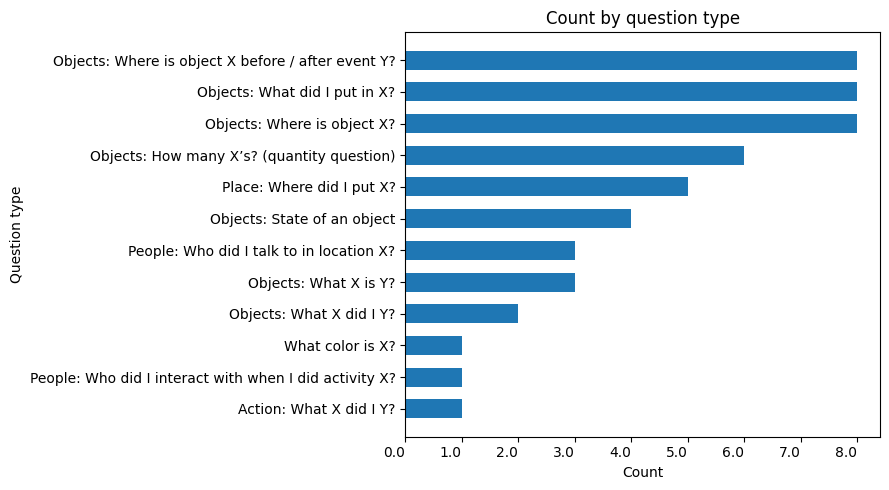

Type
Action: What X did I Y?                                   0.007303
What color is X?                                          0.009355
Objects: Where is object X before / after event Y?        0.174484
Place: Where did I put X?                                 0.211847
Objects: How many X’s? (quantity question)                0.247708
Objects: Where is object X?                               0.338998
Objects: What did I put in X?                             0.389142
Objects: What X is Y?                                     0.414865
Objects: State of an object                               0.473916
Objects: What X did I Y?                                  0.573914
People: Who did I talk to in location X?                  0.965693
People: Who did I interact with when I did activity X?    0.974677
Name: Score, dtype: float64


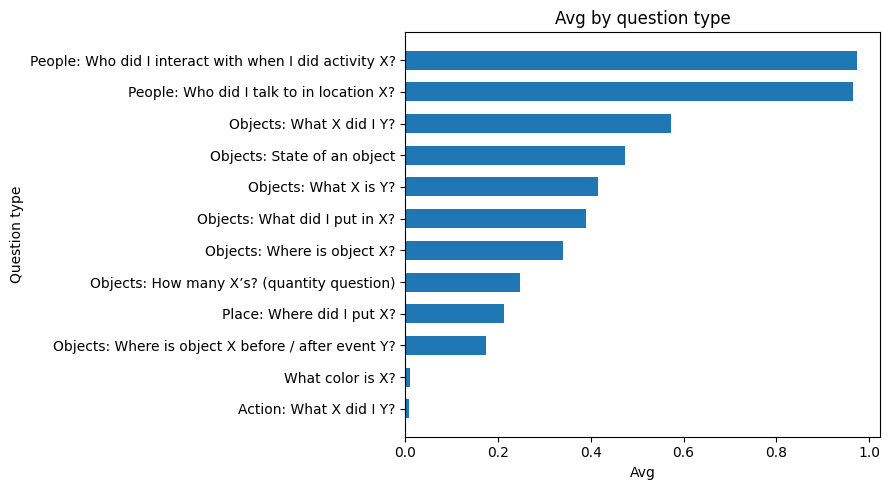

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

df  = pd.DataFrame(results_entile, columns=["Type", "Question", "Reference", "Prediction", "Score"])

count = df.groupby("Type")["Score"].count().sort_values()
fig, ax = plt.subplots(figsize=(9, 5))
ax.barh(count.index, count.values, height=0.6)
ax.set_xticklabels(ax.get_xticks(), ha="right")
ax.set_xlabel("Count")
ax.set_ylabel("Question type")
ax.set_title("Count by question type")
plt.tight_layout()
plt.show()

avg = df.groupby("Type")["Score"].mean().sort_values()
print(avg)
fig, ax = plt.subplots(figsize=(9, 5))
ax.barh(avg.index, avg.values, height=0.6)
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.1f}'))
ax.set_xlabel("Avg")
ax.set_ylabel("Question type")
ax.set_title("Avg by question type")
plt.tight_layout()
plt.show()

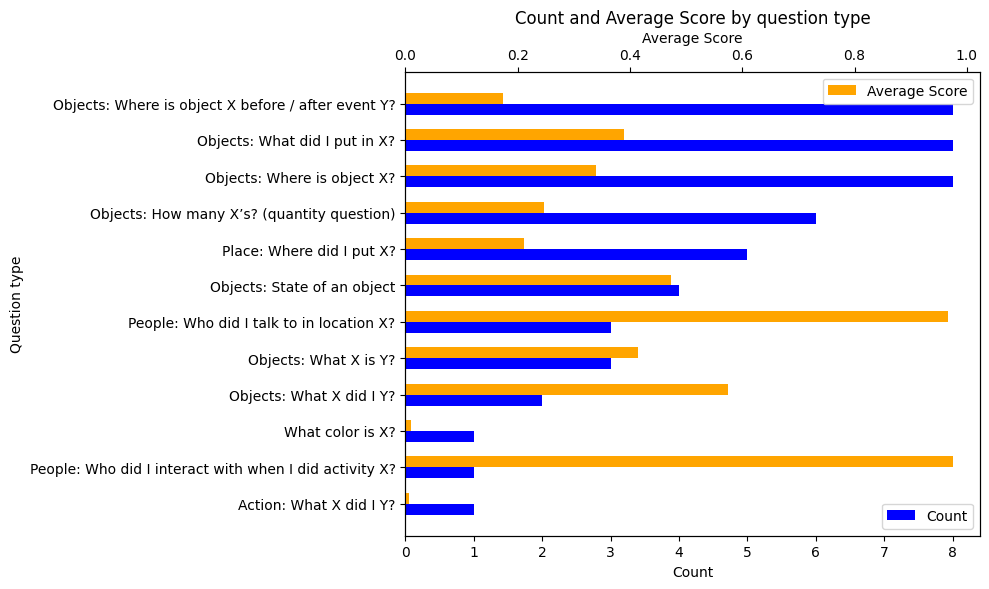

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

df = pd.DataFrame(results_entile, columns=["Type", "Question", "Reference", "Prediction", "Score"])
count = df.groupby("Type")["Score"].count().sort_values()
avg   = df.groupby("Type")["Score"].mean().reindex(count.index)

y = np.arange(len(count.index))
height = 0.3

fig, ax1 = plt.subplots(figsize=(10, 6))

ax1.barh(y - height/2, count.values, height=height, color='blue', label='Count')
ax1.set_yticks(y)
ax1.set_yticklabels(count.index)
ax1.set_xlabel("Count")
ax1.set_ylabel("Question type")

ax2 = ax1.twiny()
ax2.barh(y + height/2, avg.values, height=height, color='orange', label='Average Score')
ax2.set_xlabel("Average Score")

ax1.legend(loc='lower right')
ax2.legend(loc='upper right')

plt.title("Count and Average Score by question type")
plt.tight_layout()
plt.show()
